In [18]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns

In [19]:
import os

In [20]:

files = os.listdir('/Users/madhuradandekar/DataSc/Projects /Project 1..Uber New York Trip/Data files')
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-sep14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv']

In [21]:
path = '/Users/madhuradandekar/DataSc/Projects /Project 1..Uber New York Trip/Data files'
final = pd.DataFrame()


In [22]:
# concatinating all the data in final dataframe
for file in files:
    df = pd.read_csv(path +'/'+ file,encoding = 'ISO-8859-1')
    final = pd.concat([final,df])


In [23]:
final.shape

(4534327, 4)

In [24]:
df=final

In [25]:
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [26]:
df.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

In [27]:
df['Date/Time']=pd.to_datetime(df['Date/Time'],format ='%m/%d/%Y %H:%M:%S')

In [28]:
df.head()

,Date/Time,Lat,Lon,Base
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512


In [29]:
df['Weekday']=df['Date/Time'].dt.day_name()

In [30]:
df['day']=df['Date/Time'].dt.day
df['month']=df['Date/Time'].dt.month

df['hour']=df['Date/Time'].dt.hour

df['minute']=df['Date/Time'].dt.minute



In [31]:
df.head()

,Date/Time,Lat,Lon,Base,Weekday,day,month,hour,minute
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,4,0,11
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,4,0,17
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,4,0,21
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,4,0,28
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,4,0,33


In [32]:
df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
Weekday              object
day                   int64
month                 int64
hour                  int64
minute                int64
dtype: object

In [33]:
df['Weekday'].value_counts()

Thursday     755145
Friday       741139
Wednesday    696488
Tuesday      663789
Saturday     646114
Monday       541472
Sunday       490180
Name: Weekday, dtype: int64

In [34]:
import plotly.express as px

In [35]:
#Weekday Analysis 


In [36]:
!pip install plotly

In [37]:
df['Weekday'].value_counts()

Thursday     755145
Friday       741139
Wednesday    696488
Tuesday      663789
Saturday     646114
Monday       541472
Sunday       490180
Name: Weekday, dtype: int64

In [38]:
df['Weekday'].value_counts().index

Index(['Thursday', 'Friday', 'Wednesday', 'Tuesday', 'Saturday', 'Monday',
       'Sunday'],
      dtype='object')

In [39]:
#conclusion = Thursdays are generally busy.


px.bar(x= df['Weekday'].value_counts().index,
      y=df['Weekday'].value_counts())

In [40]:
# Monthly, Hourly Ananlysys 

In [41]:
df['month'].unique()

array([4, 8, 9, 7, 6, 5])

In [42]:

for i , month in enumerate(df['month'].unique()):
    print(i)
    print(month)
    


0
4
1
8
2
9
3
7
4
6
5
5


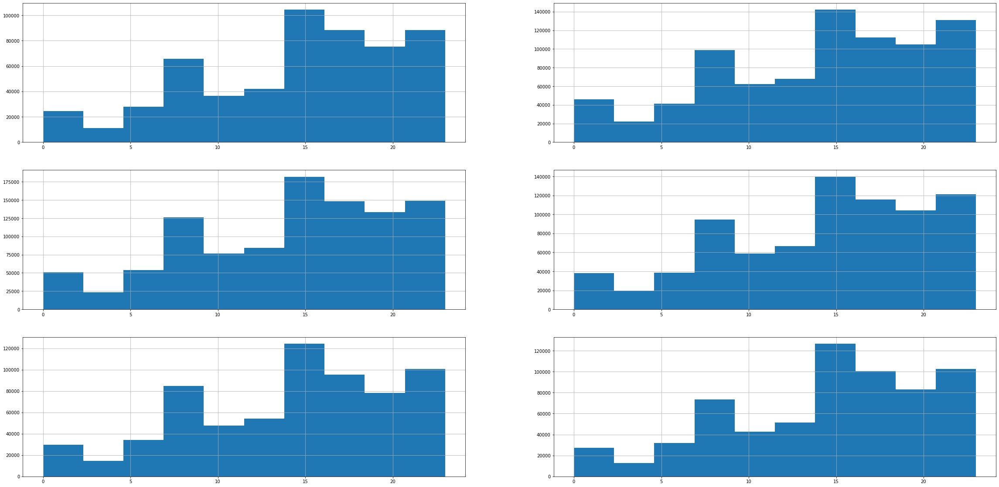

In [43]:
#subplot of every month(for 6 months ) and hourly rushtime. Evrey moth rush hours are after 3 

plt.figure(figsize =(40,20))

for i , month in enumerate(df['month'].unique()):
    plt.subplot(3,2,i+1)
    df[df['month']==month]['hour'].hist()
    


(array([216928., 103517., 227152., 543565., 324851., 366329., 819491.,
        660869., 579117., 692508.]),
 array([ 0. ,  2.3,  4.6,  6.9,  9.2, 11.5, 13.8, 16.1, 18.4, 20.7, 23. ]),
 <BarContainer object of 10 artists>)

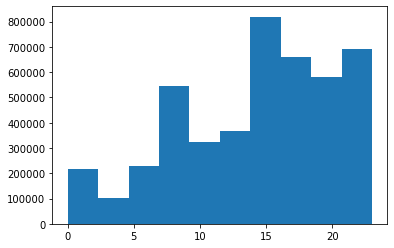

In [44]:
plt.hist(df['hour'])

In [45]:
df['hour'].value_counts()

17    336190
18    324679
16    313400
19    294513
20    284604
21    281460
15    275466
22    241858
14    230625
13    195877
7     193094
8     190504
12    170452
23    169190
11    165703
9     159967
10    159148
6     143213
0     103836
5      83939
1      67227
4      55230
3      48287
2      45865
Name: hour, dtype: int64

In [46]:
import chart_studio.plotly as py


ModuleNotFoundError: No module named 'chart_studio'

In [47]:
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode,plot,iplot

In [48]:
df.groupby('month')['hour'].count()

month
4     564516
5     652435
6     663844
7     796121
8     829275
9    1028136
Name: hour, dtype: int64

In [49]:
# Analysis of monthly Journey. 9th month (september)maximum journeys happend

trace1 = go.Bar(x=df.groupby('month')['hour'].count().index,
       y = df.groupby('month')['hour'].count(),
       name = 'Priority'
    
)

In [50]:
iplot([trace1])

Text(0.5, 1.0, 'Journeys by month day')

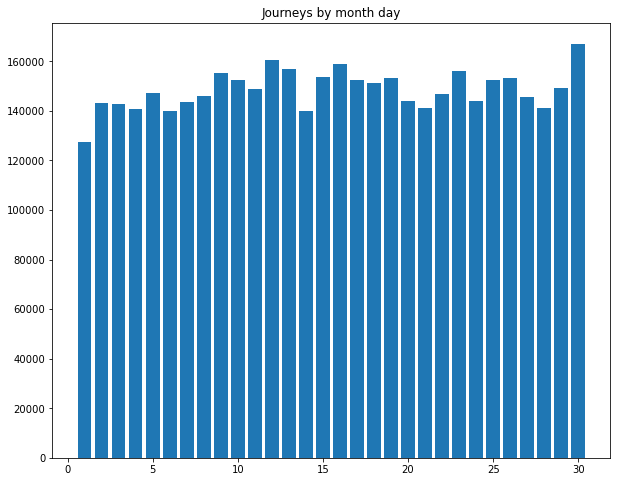

In [51]:
# Analysis of journeys Daywise. On 30th of every months maximum journeys happend 

plt.figure(figsize=(10,8))
plt.hist(df['day'],bins= 30,rwidth =0.8,range =(0.5,30.5))
plt.xlabel=('date of the month')
plt.ylabel=('Total Journeys')
plt.title('Journeys by month day')


/Users/madhuradandekar/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='day', ylabel='Density'>

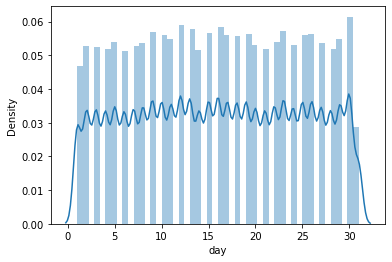

In [52]:
sns.distplot(df['day'])

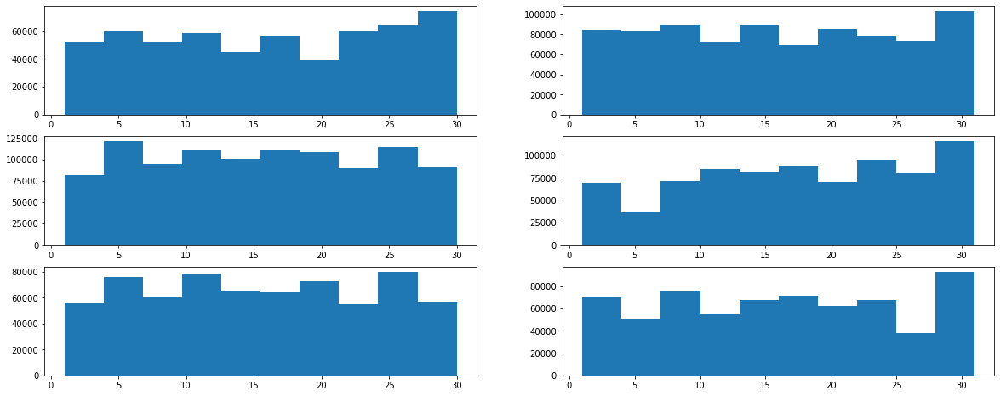

In [53]:
#Analysis of total rides monthwise
plt.figure(figsize=(20,8))

for i , month in enumerate(df['month'].unique(),1):
    plt.subplot(3,2,i)
    df_out=df[df['month']==month]
    plt.hist(df_out['day'])
    
    
    
    

<AxesSubplot:xlabel='hour', ylabel='Lat'>

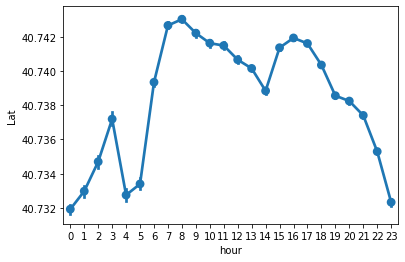

In [54]:
#Analysing rush in hour
sns.pointplot(x='hour',y='Lat',data=df)

Text(0.5, 1.0, 'hoursOfDay vs latitude of passenger')

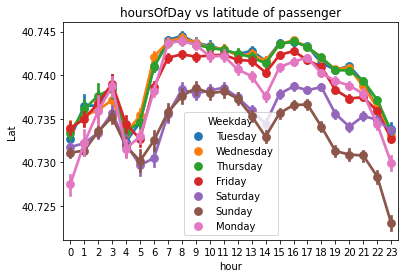

In [55]:
#Day wise analysis 
#conclusion - Monday and Thursdays are quite busy. The least busy day is Sunday due to no office or school rush.
ax = sns.pointplot(x='hour',y='Lat',data=df, hue ='Weekday')
ax.set_title('hoursOfDay vs latitude of passenger')

In [56]:
# Analyse which base number gets popular by month name 
df.head()

,Date/Time,Lat,Lon,Base,Weekday,day,month,hour,minute
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,4,0,11
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,4,0,17
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,4,0,21
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,4,0,28
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,4,0,33


In [57]:
base =df.groupby(['Base','month'])['Date/Time'].count().reset_index()
base

,Base,month,Date/Time
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472
5,B02512,9,34370
6,B02598,4,183263
7,B02598,5,260549
8,B02598,6,242975
9,B02598,7,245597


<AxesSubplot:xlabel='month', ylabel='Date/Time'>

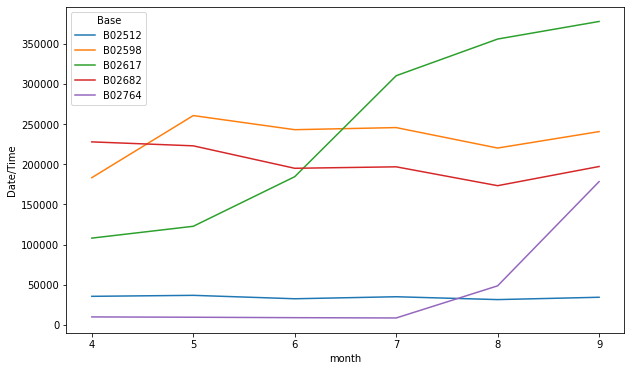

In [58]:
# conclucion - Base no B02617 became popular frpm month 4 to month 9

plt.figure(figsize=(10,6))
sns.lineplot(x='month',y='Date/Time',data=base,hue='Base')

In [59]:
#Performing cross analysis 
#1. Heatmap by hour and weekday
#2. Heatmap by hour and day
#3. Heatmap by month and day
#4. Heatmap by month and weekday

In [60]:
#creating a function 

def count_rows(rows):
    return len(rows)

In [61]:
#Weekly Analysis
by_cross =df.groupby(['Weekday','hour']).apply(count_rows)
by_cross

Weekday    hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Length: 168, dtype: int64

In [62]:
#converting into pivot table 
pivot= by_cross.unstack()
pivot

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


<AxesSubplot:xlabel='hour', ylabel='Weekday'>

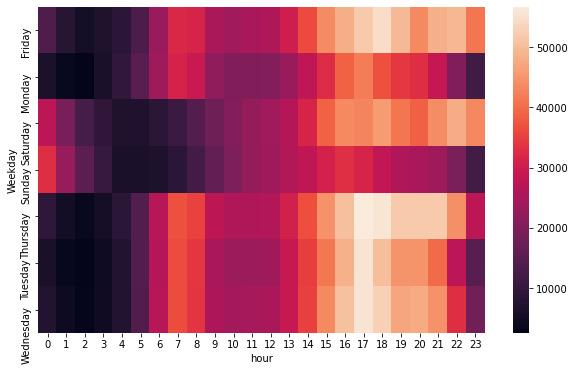

In [63]:
#ploting heatmap by weekday and hour

plt.figure(figsize=(10,6))
sns.heatmap(pivot)

# conclusion - rush hours are generally from 4pm to 9pm

In [64]:
#creating a fuction for the heatmap. which will pass the arguments in col1 and col2.

def heatmap(col1,col2):
    by_cross =df.groupby([col1,col2]).apply(count_rows)
    pivot =by_cross.unstack()
    plt.figure(figsize=(10,6))
    return sns.heatmap(pivot)
    

<AxesSubplot:xlabel='hour', ylabel='day'>

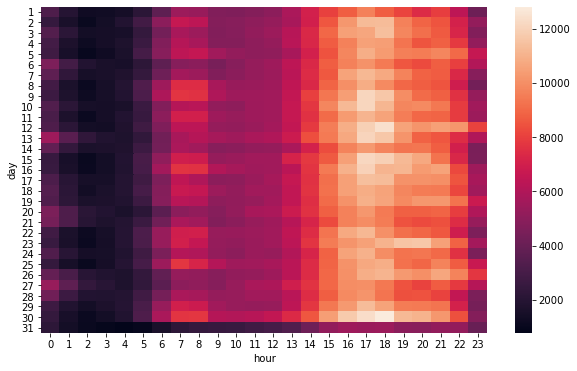

In [65]:
#daily-hourly Analysis 
heatmap('day','hour')
# all days more rush for uber ride is between 4pm and 7pm

<AxesSubplot:xlabel='day', ylabel='month'>

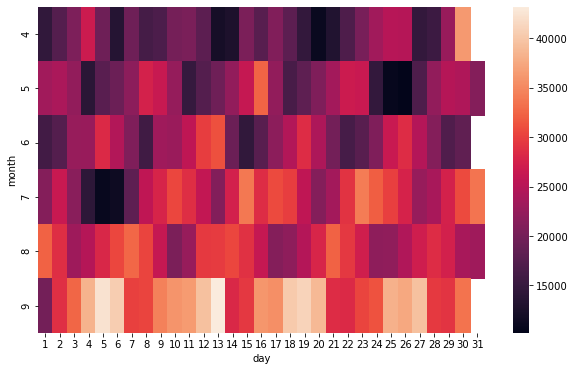

In [66]:
#Analysis for month and day
heatmap('month','day')

In [67]:
#Analysis of location data points
df.head()

,Date/Time,Lat,Lon,Base,Weekday,day,month,hour,minute
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,4,0,11
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,4,0,17
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,4,0,21
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,4,0,28
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,4,0,33


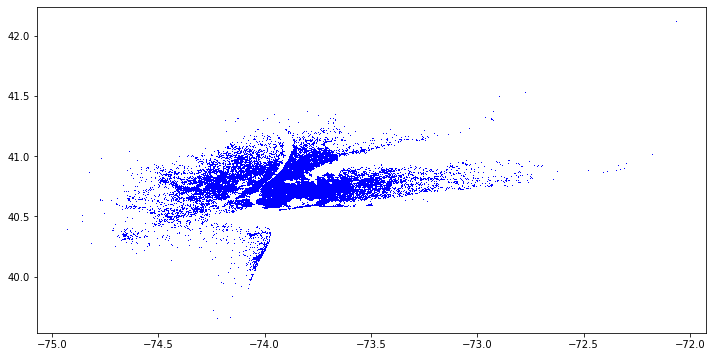

In [68]:
plt.figure(figsize=(12,6))
plt.plot(df['Lon'],df['Lat'],'b+',ms =0.5)



(40.6, 41.0)

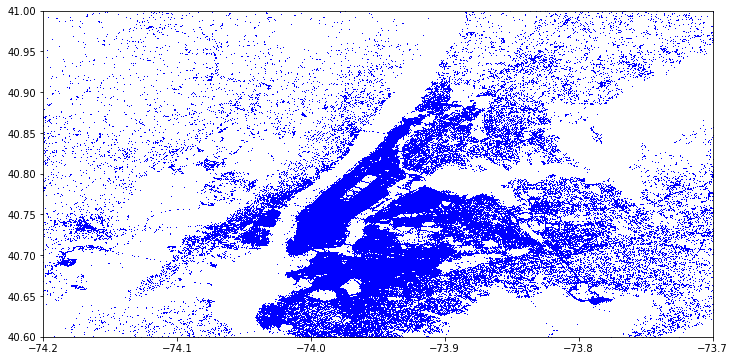

In [69]:
#improvement from the above graph by stating xlim and ylim 
plt.figure(figsize=(12,6))
plt.plot(df['Lon'],df['Lat'],'b+',ms =0.5)
plt.xlim(-74.2,-73.7)
plt.ylim(40.6,41)

#conclusion - in the region between latitude -74.0 to Longitude -73.9 theres more rush.)

In [70]:
#Anaylsis of loaction data point
#filter on sunday 
df_out=df[df['Weekday']=='Sunday']
df_out.shape

(490180, 9)

In [71]:
df_out.head()

,Date/Time,Lat,Lon,Base,Weekday,day,month,hour,minute
6965,2014-04-06 00:00:00,40.6547,-74.3033,B02512,Sunday,6,4,0,0
6966,2014-04-06 00:00:00,40.7356,-74.0006,B02512,Sunday,6,4,0,0
6967,2014-04-06 00:00:00,40.7421,-74.0041,B02512,Sunday,6,4,0,0
6968,2014-04-06 00:00:00,40.7401,-74.0053,B02512,Sunday,6,4,0,0
6969,2014-04-06 00:01:00,40.7368,-73.9877,B02512,Sunday,6,4,0,1


In [72]:
Trips  = df_out.groupby(['Lat','Lon'])['Weekday'].count().reset_index()

Trips

,Lat,Lon,Weekday
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1
...,...,...,...
209225,41.3141,-74.1249,1
209226,41.3180,-74.1298,1
209227,41.3195,-73.6905,1
209228,41.3197,-73.6903,1


In [73]:
Trips.columns=['Lat','Lon','no of trips']
Trips


,Lat,Lon,no of trips
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1
...,...,...,...
209225,41.3141,-74.1249,1
209226,41.3180,-74.1298,1
209227,41.3195,-73.6905,1
209228,41.3197,-73.6903,1


In [74]:
!pip install folium

In [75]:
from folium.plugins import HeatMap

In [76]:
import folium

In [77]:
basemap = folium.Map()

In [78]:
HeatMap(Trips,zoom=20,radius=15).add_to(basemap)
basemap
#conclusion - heamap shows the area in the city which has maximum uber rides on sunday

In [79]:
#Automte this by using functions and anlysis by any day
def plot(df, day):
    df_out=df[df['Weekday']==day]
    Trips1  = df_out.groupby(['Lat','Lon'])['Weekday'].count().reset_index()
    basemap = folium.Map()
    HeatMap(Trips,zoom=20,radius=15).add_to(basemap)
    return basemap
    
    

In [80]:
#Passing the parameter to the function plot
plot(df,'Saturday')

In [81]:
#Analysis on Uber-raw-data-janjune-15.csv.... first half of the year from jan till june 

In [82]:
uber_15=pd.read_csv(r'/Users/madhuradandekar/DataSc/Projects /Project 1..Uber New York Trip/uber-pickups-in-new-york-city/uber-raw-data-janjune-15.csv')

In [83]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [84]:
uber_15.dtypes

Dispatching_base_num    object
Pickup_date             object
Affiliated_base_num     object
locationID               int64
dtype: object

In [85]:
uber_15['Pickup_date']=pd.to_datetime(uber_15['Pickup_date'],format ='%Y-%m-%d %H:%M:%S')

In [86]:
uber_15.dtypes

Dispatching_base_num            object
Pickup_date             datetime64[ns]
Affiliated_base_num             object
locationID                       int64
dtype: object

In [87]:
uber_15['weekday']=uber_15['Pickup_date'].dt.day_name()

uber_15['day']=uber_15['Pickup_date'].dt.day
uber_15['month']=uber_15['Pickup_date'].dt.month

uber_15['hour']=uber_15['Pickup_date'].dt.hour

uber_15['minute']=uber_15['Pickup_date'].dt.minute



In [88]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,weekday,day,month,hour,minute
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,5,9,47
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,5,9,47
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,5,9,47
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,5,9,47
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,5,9,47


In [89]:
#Monthly uber pickup in newyork city
uber_15['month'].value_counts()


6    2816895
5    2695553
4    2280837
2    2263620
3    2259773
1    1953801
Name: month, dtype: int64

In [90]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,weekday,day,month,hour,minute
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,5,9,47
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,5,9,47
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,5,9,47
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,5,9,47
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,5,9,47


/Users/madhuradandekar/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



'\nconclusion - Morning time between 8 and 9 uber rides go up , then there is a dip in the aftenoon and it goes up\nagain between 6pm to 10 pm\n'

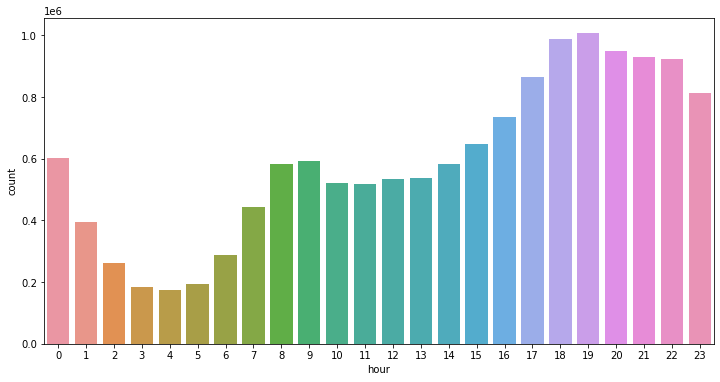

In [91]:
#Horurly Analysis for the uber rides 
plt.figure(figsize =(12,6))
sns.countplot(uber_15['hour'])

'''
conclusion - Morning time between 8 and 9 uber rides go up , then there is a dip in the aftenoon and it goes up
again between 6pm to 10 pm
'''

In [92]:
#Analysis of rush hours day wise
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,weekday,day,month,hour,minute
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,5,9,47
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,5,9,47
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,5,9,47
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,5,9,47
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,5,9,47


In [93]:
summary = uber_15.groupby(['weekday', 'hour'])['Pickup_date'].count().reset_index()
summary.head()


,weekday,hour,Pickup_date
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


In [94]:
summary.columns=['weekday','hour','counts']
summary.head()

,weekday,hour,counts
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


'Conclusion - overall evenings are quite busy especially saturday evenings\nall weekdays are busy between 8am and 9am as compared to weekends'

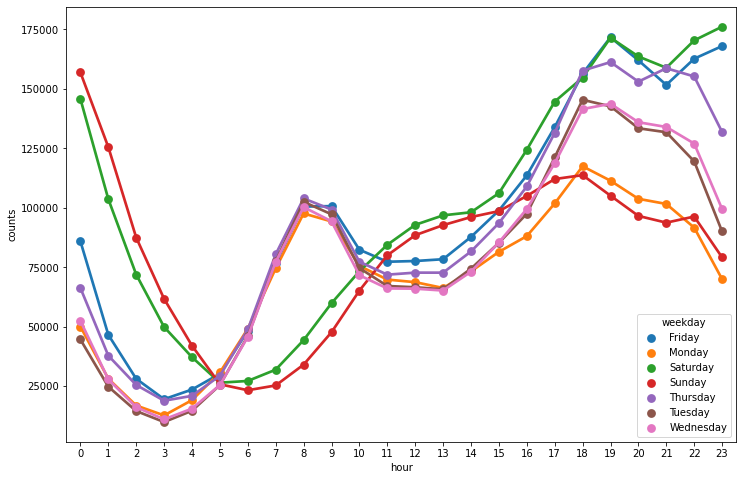

In [95]:
plt.figure(figsize=(12,8))
sns.pointplot(x='hour',y='counts',hue='weekday',data=summary)

'''Conclusion - overall evenings are quite busy especially saturday evenings
all weekdays are busy between 8am and 9am as compared to weekends'''

In [96]:
#reading a jan-feb-foil data 

uber_foil=pd.read_csv('/Users/madhuradandekar/DataSc/Projects /Project 1..Uber New York Trip/uber-pickups-in-new-york-city/Uber-Jan-Feb-FOIL.csv')
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [97]:
uber_foil['dispatching_base_number'].unique()

array(['B02512', 'B02765', 'B02764', 'B02682', 'B02617', 'B02598'],
      dtype=object)

<AxesSubplot:xlabel='dispatching_base_number', ylabel='active_vehicles'>

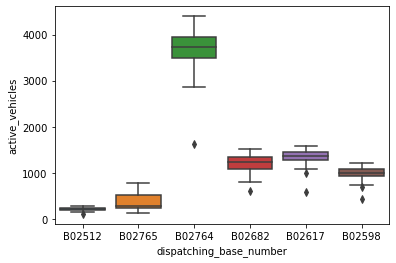

In [98]:
#Analysing which base number has most active vehicle
sns.boxplot(x='dispatching_base_number',y='active_vehicles',
           data = uber_foil)
# conclusion - baseno -BO2764 has the maximum active vehicle

In [99]:
#Analysing which base number has most trips

<AxesSubplot:xlabel='dispatching_base_number', ylabel='trips'>

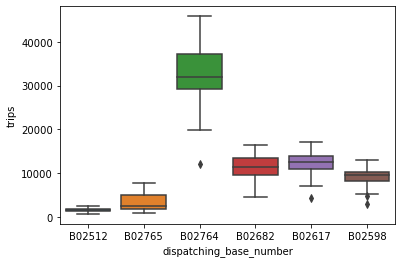

In [100]:
sns.boxplot(x='dispatching_base_number',y='trips',
           data = uber_foil)

In [101]:
#how average trips/vehicles increase/decreases with dates with each of base number
uber_foil['trips/vehicle']=uber_foil['trips']/uber_foil['active_vehicles']



In [102]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips,trips/vehicle
0,B02512,1/1/2015,190,1132,5.957895
1,B02765,1/1/2015,225,1765,7.844444
2,B02764,1/1/2015,3427,29421,8.585060
3,B02682,1/1/2015,945,7679,8.125926
4,B02617,1/1/2015,1228,9537,7.766287


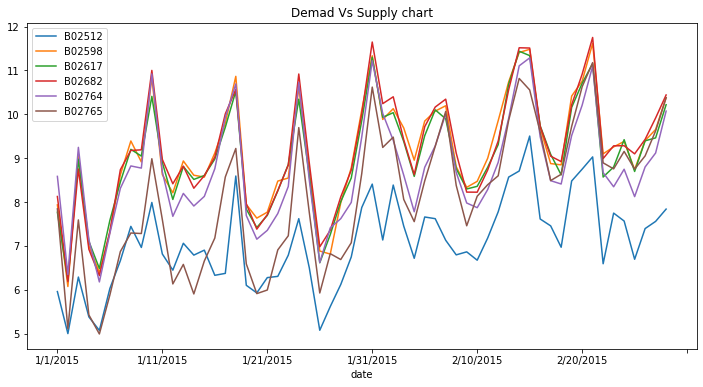

In [107]:
plt.figure(figsize=(12,6))
uber_foil.set_index('date').groupby(['dispatching_base_number'])['trips/vehicle'].plot()
plt.ylabel=('Avg trips per vehicle')
plt.title('Demad Vs Supply chart')
plt.legend()
